##readme

This notebook was created by Logan Zoellner (@nagolinc, https://loganzoellner.com)


This notebook makes use of @AydaoAI's "This Anime Does not exist" (which you can read more about here: https://www.gwern.net/Faces#extended-stylegan2-danbooru2019-aydao) and CLIP (which you can read more about here https://github.com/openai/CLIP).

Much of it was based off of this notebook: https://colab.research.google.com/github/openai/clip/blob/master/Interacting_with_CLIP.ipynb created by @openai

And this notebook: https://colab.research.google.com/drive/1oxcJ1tbG77hlggdKd_d8h22nBcIZsLTL by @arfa

TADNE is under a CC BY-NC liscence and CLIP is under the MIT Liscence.

Any code in this notebook not otherwise liscenced is herein released under the MIT Liscence.

#Import TADNE and convert to pytorch

In [ ]:
!nvidia-smi

Thu May 19 08:26:18 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!git clone https://github.com/shawwn/stylegan2 -b estimator /content/stylegan2

Cloning into '/content/stylegan2'...
remote: Enumerating objects: 1463, done.
remote: Total 1463 (delta 0), reused 0 (delta 0), pack-reused 1463
Receiving objects: 100% (1463/1463), 932.46 KiB | 25.90 MiB/s, done.
Resolving deltas: 100% (1045/1045), done.


In [ ]:
cd /content/

/content


In [ ]:
import gdown, os

if not os.path.exists("/content/network-tadne.pkl"):
  #gdown.download('https://drive.google.com/uc?id=1qNhyusI0hwBLI-HOavkNP5I0J0-kcN4C', 'network-tadne.pkl', quiet=False)
  url='https://drive.google.com/uc?id=1LCkyOPmcWBsPlQX_DxKAuPM1Ew_nh83I'
  gdown.download(url, '/content/network-tadne.pkl', quiet=False)


Downloading...
From: https://drive.google.com/uc?id=1LCkyOPmcWBsPlQX_DxKAuPM1Ew_nh83I
To: /content/network-tadne.pkl
100%|██████████| 1.06G/1.06G [00:12<00:00, 87.8MB/s]


In [ ]:
!ls -lrt /content/network-tadne.pkl

-rw-r--r-- 1 root root 1056544230 May 19 08:26 /content/network-tadne.pkl


In [ ]:
%tensorflow_version 1.x
%cd /content/stylegan2

TensorFlow 1.x selected.
/content/stylegan2


In [ ]:
import os
import pickle
import numpy as np
import PIL.Image
import dnnlib
import dnnlib.tflib as tflib
import scipy



attach_debugger <function attach_debugger at 0x7f9cfbc2dc20>
print_status <function print_status at 0x7f9cfbc2ddd0>
freeze_forever <function freeze_forever at 0x7f9cfbc2e170>
quit <function quit at 0x7f9cfbc2e440>
save_and_quit <function save_and_quit at 0x7f9cfbc2e7a0>
throw_exception <function throw_exception at 0x7f9cfbc2ea70>


In [ ]:
tflib.init_tf()
_G, _D, Gs = pickle.load(open("/content/network-tadne.pkl", "rb"))
# _G = Instantaneous snapshot of the generator. Mainly useful for resuming a previous training run.
# _D = Instantaneous snapshot of the discriminator. Mainly useful for resuming a previous training run.
# Gs = Long-term average of the generator. Yields higher-quality results than the instantaneous snapshot.

Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Compiling... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Compiling... Loading... Done.


In [ ]:

!git clone https://github.com/nagolinc/stylegan2-pytorch.git /content/stylegan2-pytorch/

Cloning into '/content/stylegan2-pytorch'...
remote: Enumerating objects: 380, done.
remote: Total 380 (delta 0), reused 0 (delta 0), pack-reused 380
Receiving objects: 100% (380/380), 122.50 MiB | 42.81 MiB/s, done.
Resolving deltas: 100% (196/196), done.


In [ ]:
!cd /content/stylegan2-pytorch/
!git pull

Already up to date.


In [ ]:
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)

if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

CUDA version: 11.1


In [ ]:
!pip install ninja

     |████████████████████████████████| 108 kB 28.3 MB/s 


In [ ]:
! pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |███████████████████████         | 834.1 MB 1.2 MB/s eta 0:04:30tcmalloc: large alloc 1147494400 bytes == 0x3a336000 @  0x7fd4ca21c615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |█████████████████████████████▏  | 1055.7 MB 1.4 MB/s eta 0:01:13tcmalloc: large alloc 1434370048 bytes == 0x7e98c000 @  0x7fd4ca21c615 0x592b76 0x4df71e 0x59afff 0x515655 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x5127f1 0x598e3b 0x511f68 0x598e3b 0x511f68 0x598e3b 0x511f68 0x4bc98a 0x532e76 0x594b72 0x515600 0x549576 0x593fce 0x548ae9 0x5127f1 0x549576 0x593fce 0x5118f8 0x593dd7
     |████████████████████████████████| 1156.7 MB 1.2 MB/s eta 0:00:01tcmalloc: large alloc 1445945344 bytes =

In [ ]:
%cd /content/stylegan2-pytorch


/content/stylegan2-pytorch


In [ ]:
%cd /content/stylegan2-pytorch
from convert_weight import convertStyleGan2

/content/stylegan2-pytorch


In [ ]:
#conver the model from tf to torch
ckpt, g, disc,g_train = convertStyleGan2(_G,_D,Gs)
latent_avg=ckpt["latent_avg"]

In [ ]:
import torch

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
def fmtImg(r):
    img = ((r+1)/2*256).clip(0,255).astype(np.uint8).transpose(1,2,0)
    return PIL.Image.fromarray(img, 'RGB')

In [ ]:
device='cuda'
n_sample=1

g = g.to(device)

inputSize=1024

z = np.random.RandomState(0).randn(n_sample, inputSize).astype("float32")

with torch.no_grad():
    img_pt, _ = g(
        [torch.from_numpy(z).to(device)],
        truncation=0.5,
        truncation_latent=latent_avg.to(device),
        randomize_noise=False,
    )

Gs_kwargs = dnnlib.EasyDict()
Gs_kwargs.randomize_noise = False
#img_tf = g_ema.run(z, None, **Gs_kwargs)
img_tf = Gs.run(z, None, **Gs_kwargs)
img_tf = torch.from_numpy(img_tf).to(device)

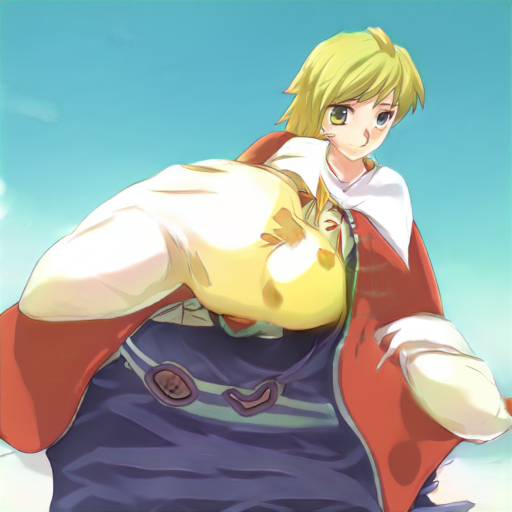

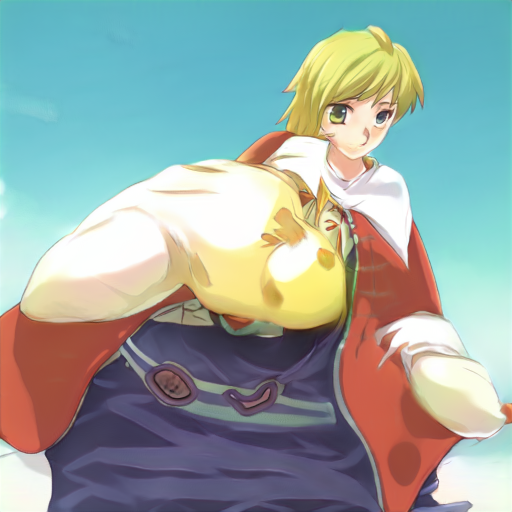

In [ ]:
#verify that these images match
img=img_pt.cpu().numpy()[0]
display(fmtImg(img))
img = img_tf.cpu().numpy()[0]
display(fmtImg(img))

In [ ]:
#and do we get the same output for D and disc?
device='cuda'

img=img_tf.cpu().numpy()
score0=_D.run(img,None)
disc.to(device)
with torch.no_grad():
    score1 = disc(
          torch.from_numpy(img).to(device)
    )
#verify that these scores match
print(score0,score1)

[[-3.699959]] tensor([[-3.7000]], device='cuda:0')


### Import CLIP

In [ ]:
MODELS = {
    "RN50": "https://openaipublic.azureedge.net/clip/models/afeb0e10f9e5a86da6080e35cf09123aca3b358a0c3e3b6c78a7b63bc04b6762/RN50.pt",
    "RN101": "https://openaipublic.azureedge.net/clip/models/8fa8567bab74a42d41c5915025a8e4538c3bdbe8804a470a72f30b0d94fab599/RN101.pt",
    "RN50x4": "https://openaipublic.azureedge.net/clip/models/7e526bd135e493cef0776de27d5f42653e6b4c8bf9e0f653bb11773263205fdd/RN50x4.pt",
    "RN50x16": "https://openaipublic.azureedge.net/clip/models/52378b407f34354e150460fe41077663dd5b39c54cd0bfd2b27167a4a06ec9aa/RN50x16.pt",
    "RN50x64": "https://openaipublic.azureedge.net/clip/models/be1cfb55d75a9666199fb2206c106743da0f6468c9d327f3e0d0a543a9919d9c/RN50x64.pt",
    "ViT-B/32": "https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt",
    "ViT-B/16": "https://openaipublic.azureedge.net/clip/models/5806e77cd80f8b59890b7e101eabd078d9fb84e6937f9e85e4ecb61988df416f/ViT-B-16.pt",
    "ViT-L/14": "https://openaipublic.azureedge.net/clip/models/b8cca3fd41ae0c99ba7e8951adf17d267cdb84cd88be6f7c2e0eca1737a03836/ViT-L-14.pt",
    "ViT-L/14@336px": "https://openaipublic.azureedge.net/clip/models/3035c92b350959924f9f00213499208652fc7ea050643e8b385c2dac08641f02/ViT-L-14-336px.pt",
}

In [ ]:
! wget {MODELS["ViT-L/14@336px"]} -O model.pt

--2022-05-19 08:33:47--  https://openaipublic.azureedge.net/clip/models/3035c92b350959924f9f00213499208652fc7ea050643e8b385c2dac08641f02/ViT-L-14-336px.pt
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.40, 13.107.213.40, 2620:1ec:bdf::40, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.40|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 934088680 (891M) [application/octet-stream]
Saving to: ‘model.pt’

model.pt            100%[===================>] 890.82M  16.0MB/s    in 61s     

2022-05-19 08:34:48 (14.7 MB/s) - ‘model.pt’ saved [934088680/934088680]



In [ ]:
model = torch.jit.load("model.pt").cuda().eval()
input_resolution = model.input_resolution.item()
context_length = model.context_length.item()
vocab_size = model.vocab_size.item()

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 427,944,193
Input resolution: 336
Context length: 77
Vocab size: 49408


## Image Preprocessing

We resize the input images and center-crop them to conform with the image resolution that the model expects. Before doing so, we will normalize the pixel intensity using the dataset mean and standard deviation.



In [ ]:
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from PIL import Image

preprocess = Compose([
    Resize(input_resolution, interpolation=Image.BICUBIC),
    CenterCrop(input_resolution),
    ToTensor()
])

image_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).cuda()
image_std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).cuda()

## Text Preprocessing

We use a case-insensitive tokenizer. The tokenizer code is hidden in the second cell below

In [ ]:
! pip install ftfy regex
! wget https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz -O bpe_simple_vocab_16e6.txt.gz

--2022-05-19 08:35:43--  https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.40, 13.107.213.40, 2620:1ec:bdf::40, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.40|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1356917 (1.3M) [application/octet-stream]
Saving to: ‘bpe_simple_vocab_16e6.txt.gz’

bpe_simple_vocab_16 100%[===================>]   1.29M  3.74MB/s    in 0.3s    

2022-05-19 08:35:44 (3.74 MB/s) - ‘bpe_simple_vocab_16e6.txt.gz’ saved [1356917/1356917]



In [ ]:
#@title

import gzip
import html
import os
from functools import lru_cache

import ftfy
import regex as re


@lru_cache()
def bytes_to_unicode():
    """
    Returns list of utf-8 byte and a corresponding list of unicode strings.
    The reversible bpe codes work on unicode strings.
    This means you need a large # of unicode characters in your vocab if you want to avoid UNKs.
    When you're at something like a 10B token dataset you end up needing around 5K for decent coverage.
    This is a signficant percentage of your normal, say, 32K bpe vocab.
    To avoid that, we want lookup tables between utf-8 bytes and unicode strings.
    And avoids mapping to whitespace/control characters the bpe code barfs on.
    """
    bs = list(range(ord("!"), ord("~")+1))+list(range(ord("¡"), ord("¬")+1))+list(range(ord("®"), ord("ÿ")+1))
    cs = bs[:]
    n = 0
    for b in range(2**8):
        if b not in bs:
            bs.append(b)
            cs.append(2**8+n)
            n += 1
    cs = [chr(n) for n in cs]
    return dict(zip(bs, cs))


def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs


def basic_clean(text):
    text = ftfy.fix_text(text)
    text = html.unescape(html.unescape(text))
    return text.strip()


def whitespace_clean(text):
    text = re.sub(r'\s+', ' ', text)
    text = text.strip()
    return text


class SimpleTokenizer(object):
    def __init__(self, bpe_path: str = "bpe_simple_vocab_16e6.txt.gz"):
        self.byte_encoder = bytes_to_unicode()
        self.byte_decoder = {v: k for k, v in self.byte_encoder.items()}
        merges = gzip.open(bpe_path).read().decode("utf-8").split('\n')
        merges = merges[1:49152-256-2+1]
        merges = [tuple(merge.split()) for merge in merges]
        vocab = list(bytes_to_unicode().values())
        vocab = vocab + [v+'</w>' for v in vocab]
        for merge in merges:
            vocab.append(''.join(merge))
        vocab.extend(['<|startoftext|>', '<|endoftext|>'])
        self.encoder = dict(zip(vocab, range(len(vocab))))
        self.decoder = {v: k for k, v in self.encoder.items()}
        self.bpe_ranks = dict(zip(merges, range(len(merges))))
        self.cache = {'<|startoftext|>': '<|startoftext|>', '<|endoftext|>': '<|endoftext|>'}
        self.pat = re.compile(r"""<\|startoftext\|>|<\|endoftext\|>|'s|'t|'re|'ve|'m|'ll|'d|[\p{L}]+|[\p{N}]|[^\s\p{L}\p{N}]+""", re.IGNORECASE)

    def bpe(self, token):
        if token in self.cache:
            return self.cache[token]
        word = tuple(token[:-1]) + ( token[-1] + '</w>',)
        pairs = get_pairs(word)

        if not pairs:
            return token+'</w>'

        while True:
            bigram = min(pairs, key = lambda pair: self.bpe_ranks.get(pair, float('inf')))
            if bigram not in self.bpe_ranks:
                break
            first, second = bigram
            new_word = []
            i = 0
            while i < len(word):
                try:
                    j = word.index(first, i)
                    new_word.extend(word[i:j])
                    i = j
                except:
                    new_word.extend(word[i:])
                    break

                if word[i] == first and i < len(word)-1 and word[i+1] == second:
                    new_word.append(first+second)
                    i += 2
                else:
                    new_word.append(word[i])
                    i += 1
            new_word = tuple(new_word)
            word = new_word
            if len(word) == 1:
                break
            else:
                pairs = get_pairs(word)
        word = ' '.join(word)
        self.cache[token] = word
        return word

    def encode(self, text):
        bpe_tokens = []
        text = whitespace_clean(basic_clean(text)).lower()
        for token in re.findall(self.pat, text):
            token = ''.join(self.byte_encoder[b] for b in token.encode('utf-8'))
            bpe_tokens.extend(self.encoder[bpe_token] for bpe_token in self.bpe(token).split(' '))
        return bpe_tokens

    def decode(self, tokens):
        text = ''.join([self.decoder[token] for token in tokens])
        text = bytearray([self.byte_decoder[c] for c in text]).decode('utf-8', errors="replace").replace('</w>', ' ')
        return text


#Gradient Descent
We calculate a score based off of:
1. Clip score for the description string
2. Discriminator score from TADNE
3. Regularize, since TADNE expects inputs that are unit normal

In [ ]:
from tqdm.notebook import tqdm, trange

In [ ]:
_preprocess = torch.nn.Sequential(
    Resize(input_resolution, interpolation=Image.BICUBIC),
    CenterCrop(input_resolution),
)


In [ ]:
def getScoringFunction(description,phi=1.0,regularization=-0.01/1024,discriminatorWeight=0.001):
  #preprocess text
  texts=[description]  
  tokenizer = SimpleTokenizer()
  text_tokens = [tokenizer.encode("This is " + desc) for desc in texts]
  text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
  for i, tokens in enumerate(text_tokens):
      text_input[i, :len(tokens)] = torch.tensor(tokens)
  text_input = text_input.cuda()

  #this function takes a (latent) as input and returns a PIL image
  # latents can be generated using 
  # latent = np.random.RandomState(seed).randn(1, 1024)
  def displayLatent(latent,phi=phi):
    with torch.no_grad():
      img_pt, _ = g(
          [torch.from_numpy(latent).to(device)],
          truncation=phi,
          truncation_latent=latent_avg.to(device),
          randomize_noise=False,
      )
    img=img_pt.cpu().numpy()[0]
    return fmtImg(img)
  
  #this function takes a latent and returns a score and a derivative
  def scoreLatent(latent,phi=phi,regularization=regularization,discriminatorWeight=discriminatorWeight):
    with torch.no_grad():
      _latent=torch.from_numpy(latent).to(device)
      #compute img array from latent
      img_pt, _ = g(
          [_latent],
          truncation=phi,
          truncation_latent=latent_avg.to(device),
          randomize_noise=False,
      )
      #pass through CLIP
      image_input = _preprocess(img_pt)
      image_features = model.encode_image(image_input).float()
      text_features = model.encode_text(text_input).float()    
      #cosine
      image_features_n= image_features/image_features.norm(dim=-1, keepdim=True)
      text_features_n=text_features/text_features.norm(dim=-1, keepdim=True)
      similarity = text_features_n @ image_features_n.T
      #clip score is just the similarity
      clipScore=similarity.sum()
      #discriminator
      discScore=disc(img_pt)
      #regularization
      l2reg=(_latent**2).sum()
      loss=l2reg*regularization-discScore*discriminatorWeight-clipScore
    score=loss.cpu().numpy().flatten()[0][0]
    return score

  def scoreLatent3(latent,phi=phi,regularization=regularization,discriminatorWeight=discriminatorWeight):
    with torch.no_grad():
      _latent=torch.from_numpy(latent).to(device)
      #compute img array from latent
      img_pt, _ = g(
          [_latent],
          truncation=phi,
          truncation_latent=latent_avg.to(device),
          randomize_noise=False,
      )
      #pass through CLIP
      image_input = _preprocess(img_pt)
      image_features = model.encode_image(image_input).float()
      text_features = model.encode_text(text_input).float()    
      #cosine
      image_features_n= image_features/image_features.norm(dim=-1, keepdim=True)
      text_features_n=text_features/text_features.norm(dim=-1, keepdim=True)
      similarity = text_features_n @ image_features_n.T
      #clip score is just the similarity
      clipScore=similarity.sum()
      #discriminator
      discScore=disc(img_pt)
      #regularization
      l2reg=(_latent**2).sum()
      loss=l2reg*regularization-discScore*discriminatorWeight-clipScore
    return clipScore.cpu().item(),discScore.cpu().numpy()[0][0],l2reg.cpu().item(),loss.cpu().item()

  #this function takes a latent and returns a score and a derivative
  def gradientDescent(latent,nSteps,phi=phi,regularization=regularization,discriminatorWeight=discriminatorWeight,lr=0.01):

    _latent=torch.from_numpy(latent).to(device)
    _latent.requires_grad=True

    #optim=torch.optim.Adam([_latent], lr=lr)
    #optim=torch.optim.SGD([_latent], lr=lr)
    optim=torch.optim.AdamW([_latent])

    for step in range(nSteps):
      #clear gradient
      optim.zero_grad()
      #compute img array from latent
      img_pt, _ = g(
          [_latent],
          truncation=phi,
          truncation_latent=latent_avg.to(device),
          randomize_noise=False,
      )
      #send through CLIP
      image_input = _preprocess(img_pt)
      image_features = model.encode_image(image_input).float()
      text_features = model.encode_text(text_input).float()      
      #compute CosDistance
      image_features_n= image_features/image_features.norm(dim=-1, keepdim=True)
      text_features_n=text_features/text_features.norm(dim=-1, keepdim=True)
      similarity = text_features_n @ image_features_n.T
      #appy loss
      #clip score is just the similarity
      clipScore=similarity.sum()
      #discriminator
      discScore=disc(img_pt)
      #regularization
      l2reg=(_latent**2).sum()
      loss=l2reg*regularization-discScore*discriminatorWeight-clipScore
      #compute gradient
      loss.backward()
      #step optimizer
      if step<nSteps-1:
        optim.step()
    score=loss.detach().cpu().numpy()[0][0]
    
    return score,_latent.detach().cpu().numpy()

  return scoreLatent3,displayLatent,gradientDescent

In [ ]:
def searchAndClimb(description,n,k,t,phi=1.0,regularization=0.005/1024,discriminatorWeight=0.001,show=False):
  '''
  First generate n examples and score them
   then take the top k scoring examples and run t steps of hill-climbing
  '''
  #generate scoring function
  scoreLatent3,displayLatent,gradientDescent=getScoringFunction(description,phi=1.0,regularization=0.005/1024,discriminatorWeight=0.001)
  #generate n results and take the top k
  latents=[]
  scores=[]
  for i in trange(n):
    latent = np.random.RandomState().randn(1, 1024).astype("float32")
    score=scoreLatent3(latent)[-1]
    scores+=[score]
    latents+=[latent]
  topK=np.argsort(scores)[:k]
  #run hill climbing t steps on winning
  results=[]
  for i in trange(k):
    _score,_result=gradientDescent(latents[topK[i]],t,lr=0.07)
    results+=[(_result,_score)]
    if show:
      print(i,scores[topK[i]],scoreLatent3(_result))
      display(displayLatent(_result))
  return results


#and now we can finally do the search
The main variables to tweak are:
0. description, the string to search for
1. n, the number of inital latents to test
2. k, the number of "top" latents to pass to hill climbing stage
3. t, the number of hill-climbing steps to take

Also, if show=True, it will print out the score and display image for
 each of the top k results


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

0 -0.18413835763931274 (0.1824449598789215, -2.0658917, 1111.4569091796875, -0.17495203018188477)


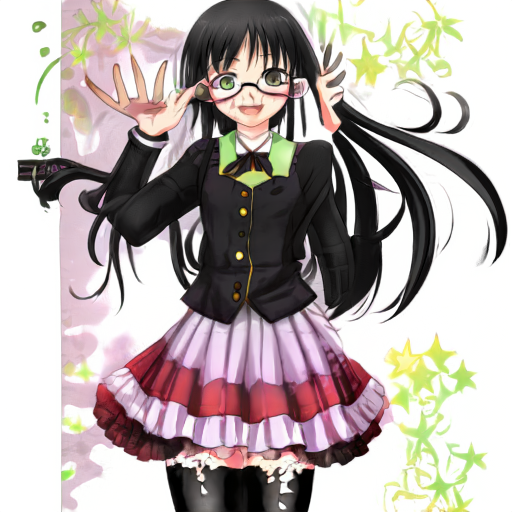

1 -0.1821604073047638 (0.18346089124679565, -2.5020776, 1035.2716064453125, -0.175903782248497)


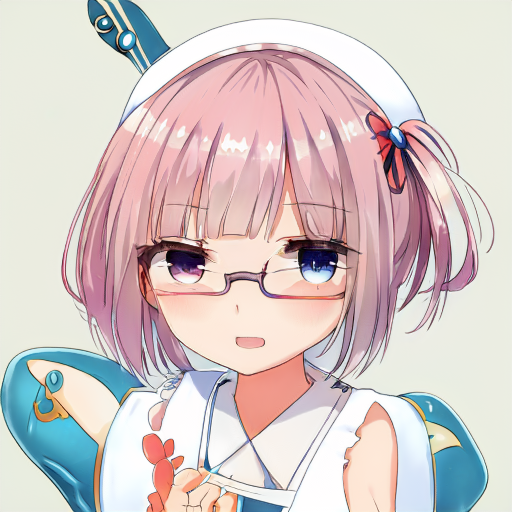

2 -0.17450861632823944 (0.18543799221515656, -2.456047, 1038.15625, -0.17791281640529633)


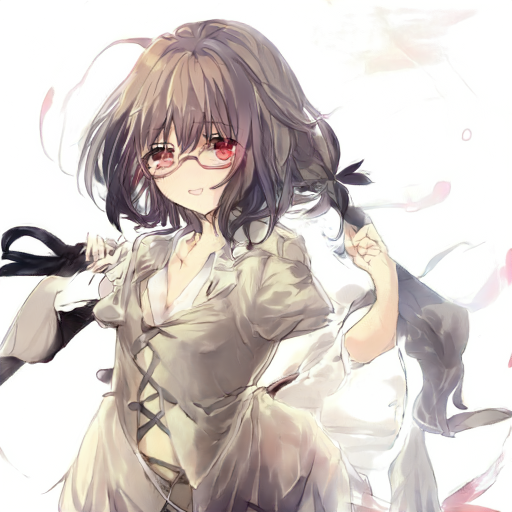

3 -0.17431065440177917 (0.19047290086746216, -2.904032, 1046.456787109375, -0.18245922029018402)


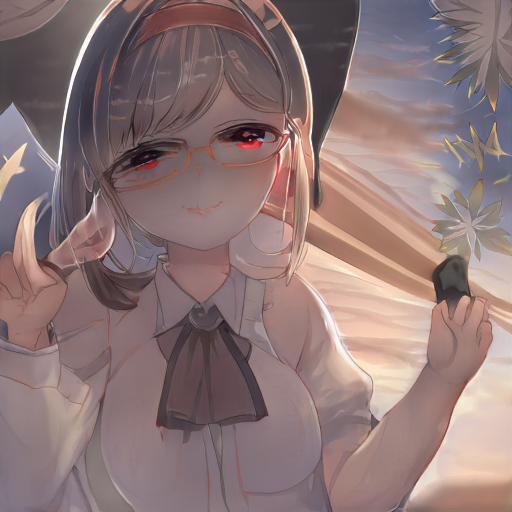

4 -0.16749629378318787 (0.16766828298568726, -0.4698298, 985.6217041015625, -0.16238585114479065)


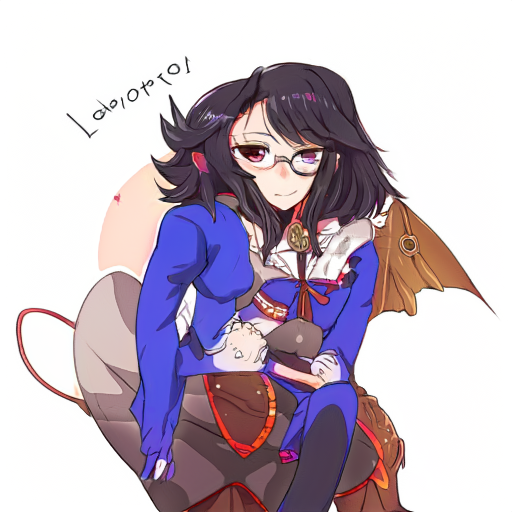

5 -0.16435126960277557 (0.16723711788654327, -3.6391113, 1035.3553466796875, -0.15854255855083466)


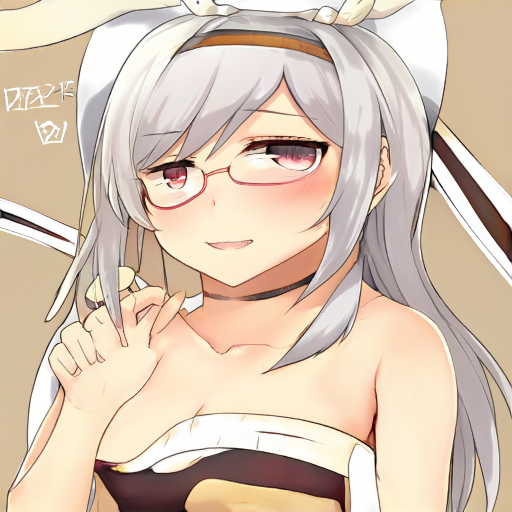

6 -0.16277892887592316 (0.1659771203994751, -1.3739331, 1035.7635498046875, -0.15954574942588806)


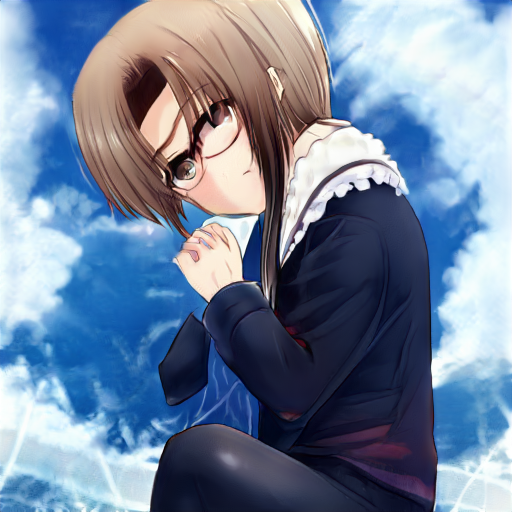

7 -0.16183510422706604 (0.17438973486423492, -2.8956125, 968.558349609375, -0.16676484048366547)


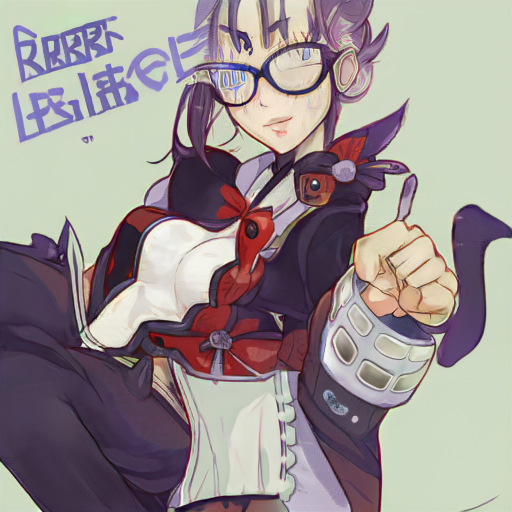

8 -0.15741491317749023 (0.1683972179889679, -4.339466, 1008.44970703125, -0.1591336876153946)


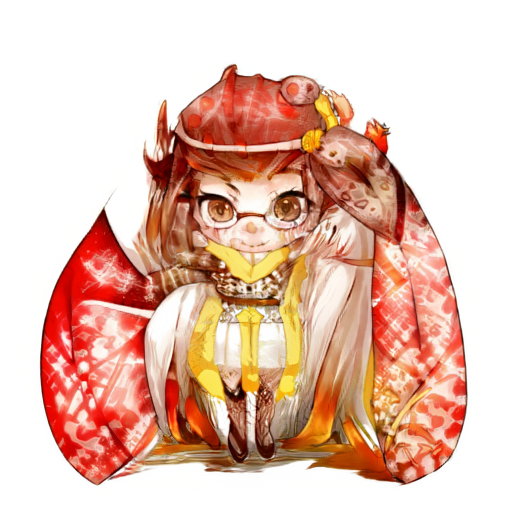

9 -0.1556243896484375 (0.17217899858951569, -3.0457146, 1056.28125, -0.16397565603256226)


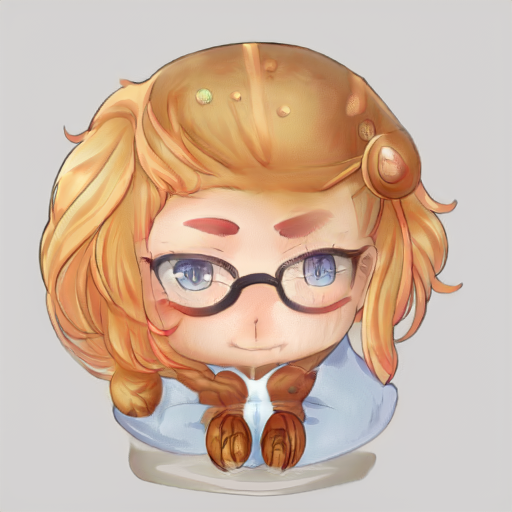

In [ ]:
results=searchAndClimb("a girl wearing glasses",1000,10,100,show=True)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

0 -0.20932944118976593 (0.24717751145362854, -2.0667677, 1067.634521484375, -0.239897683262825)


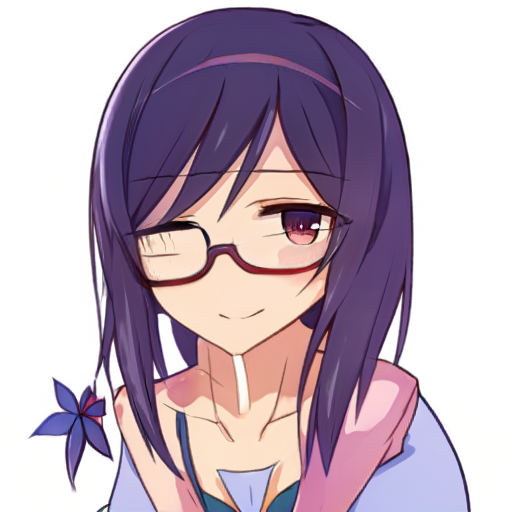

1 -0.19965723156929016 (0.22857125103473663, -1.6598656, 1025.7366943359375, -0.22190290689468384)


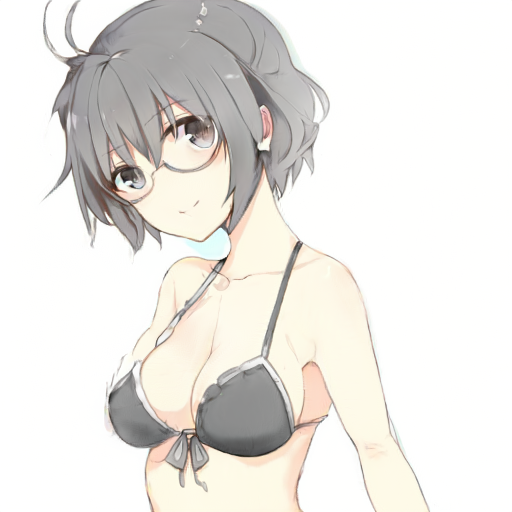

2 -0.19840094447135925 (0.23206976056098938, -3.12512, 1055.208251953125, -0.22379225492477417)


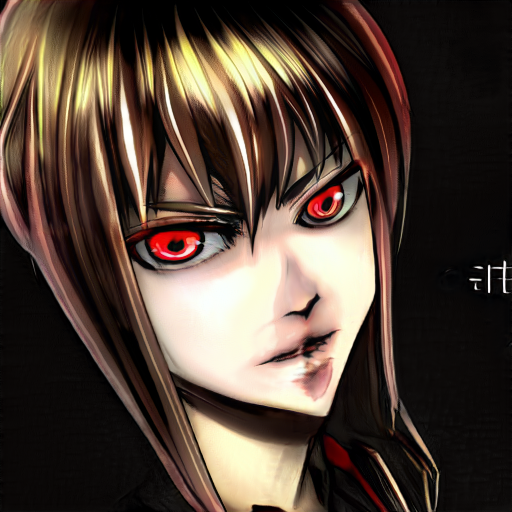

3 -0.19729502499103546 (0.2221609354019165, -2.7801216, 1134.595458984375, -0.2138407975435257)


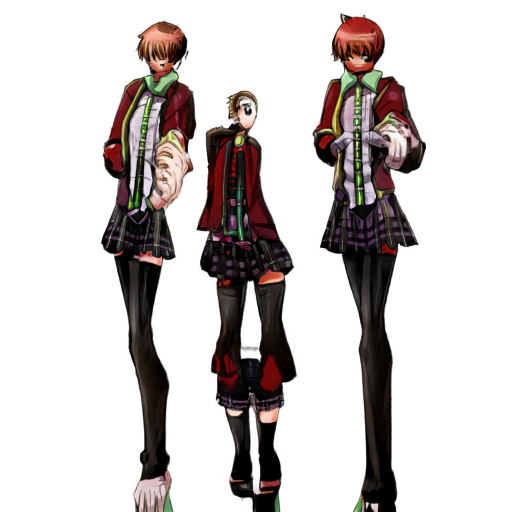

4 -0.19655419886112213 (0.253715455532074, -0.16705608, 1019.6022338867188, -0.24856987595558167)


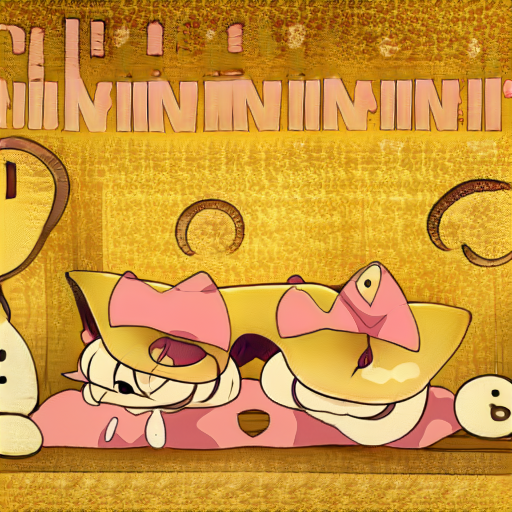

5 -0.19616352021694183 (0.22698596119880676, 1.7619276, 1041.12744140625, -0.22366425395011902)


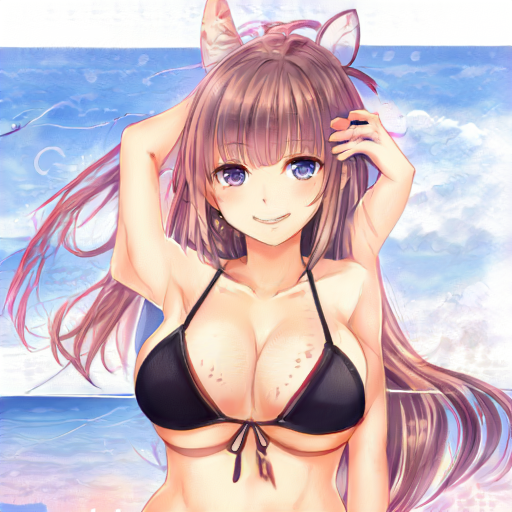

6 -0.19400957226753235 (0.21498224139213562, -4.055936, 1028.75146484375, -0.20590311288833618)


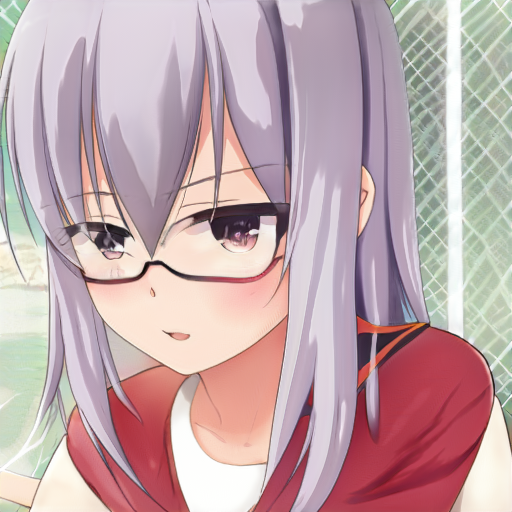

7 -0.1920020580291748 (0.2189106047153473, -1.254055, 1012.8626098632812, -0.2127109318971634)


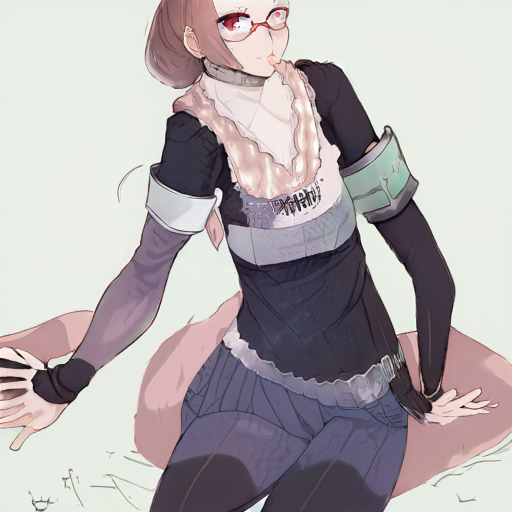

8 -0.18962371349334717 (0.23627856373786926, -1.1516776, 943.5062866210938, -0.23051992058753967)


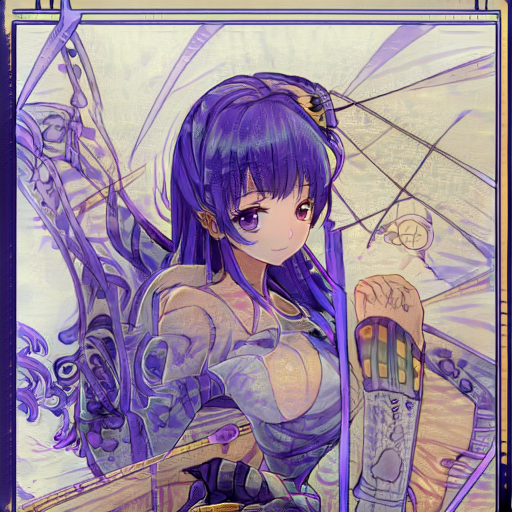

9 -0.18869639933109283 (0.2234744429588318, -0.013971329, 986.25537109375, -0.21864476799964905)


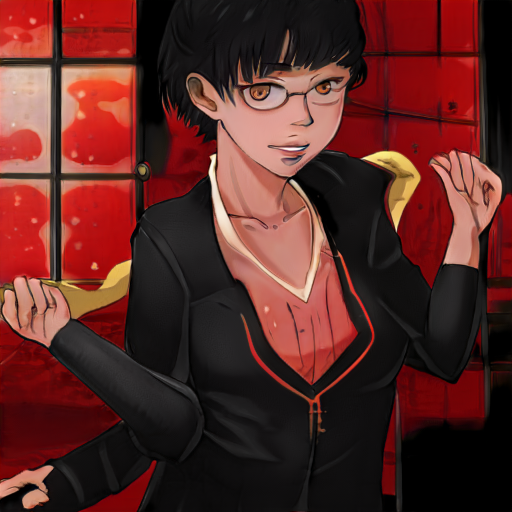

In [ ]:
results=searchAndClimb("a girl wearing glasses",1000,10,100,show=True)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

0 -0.18539276719093323 (0.20410415530204773, -4.0818415, 1008.817626953125, -0.1950964480638504)


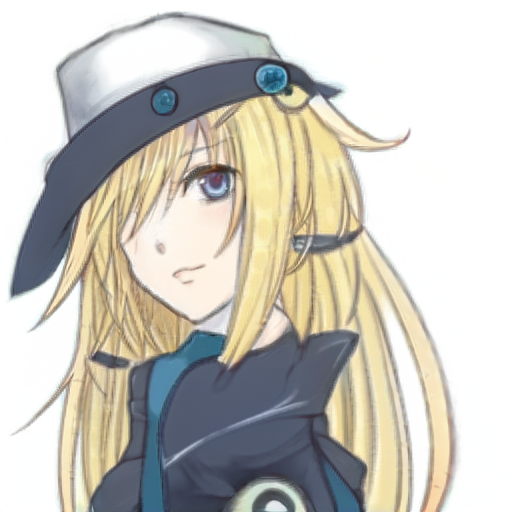

1 -0.1813056766986847 (0.15285861492156982, 1.5966184, 978.9979858398438, -0.14967496693134308)


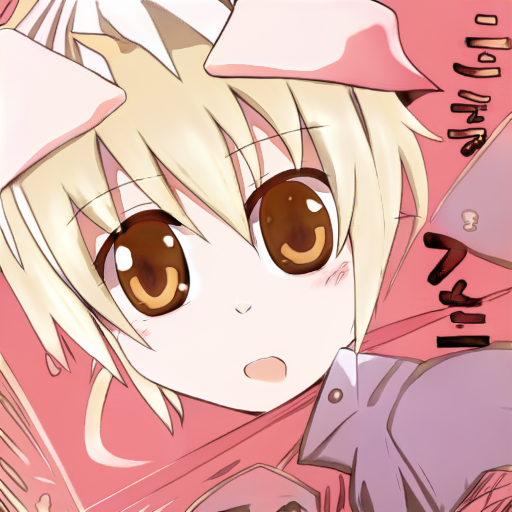

2 -0.17831207811832428 (0.188540518283844, -1.5663583, 964.5105590820312, -0.18226464092731476)


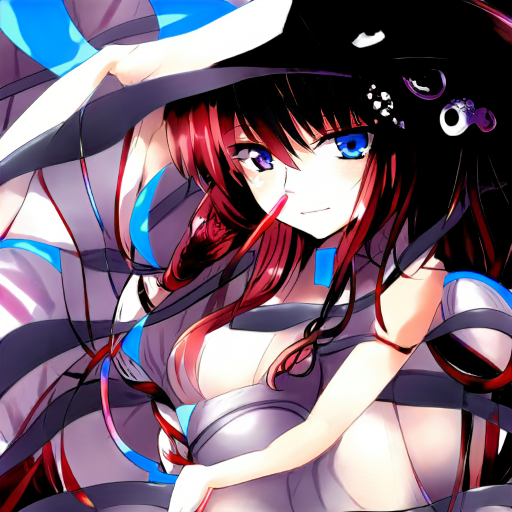

3 -0.17620113492012024 (0.17683249711990356, -2.3667972, 978.7957763671875, -0.169686421751976)


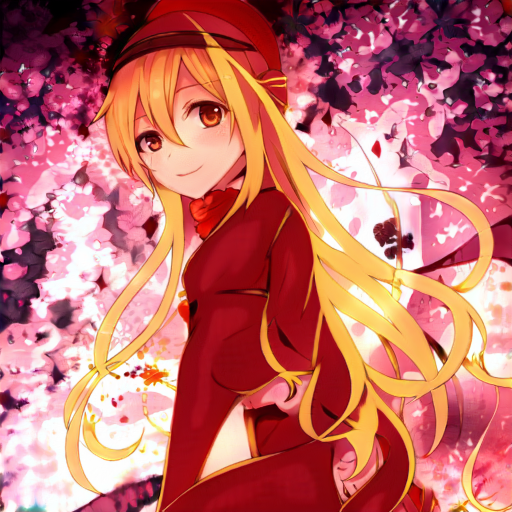

4 -0.17608073353767395 (0.17592725157737732, -2.0281672, 985.5340576171875, -0.16908690333366394)


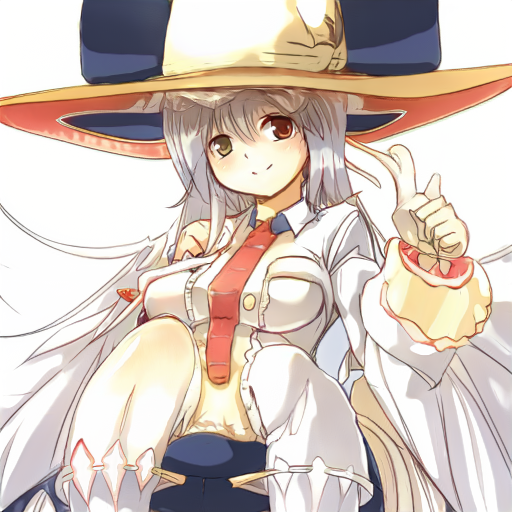

5 -0.17244330048561096 (0.17652204632759094, -2.683661, 922.8670654296875, -0.16933220624923706)


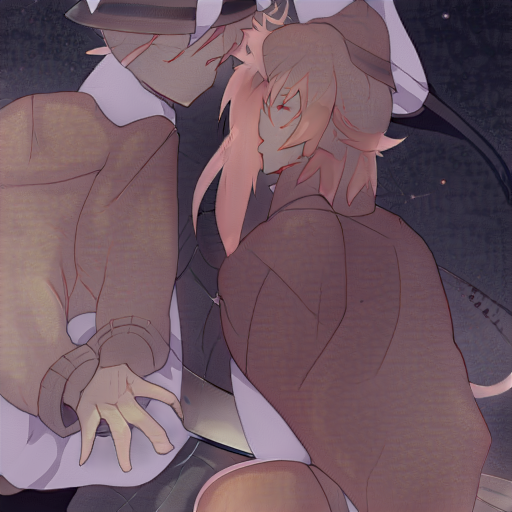

6 -0.16991856694221497 (0.14767208695411682, 0.22580862, 1019.70068359375, -0.1429188847541809)


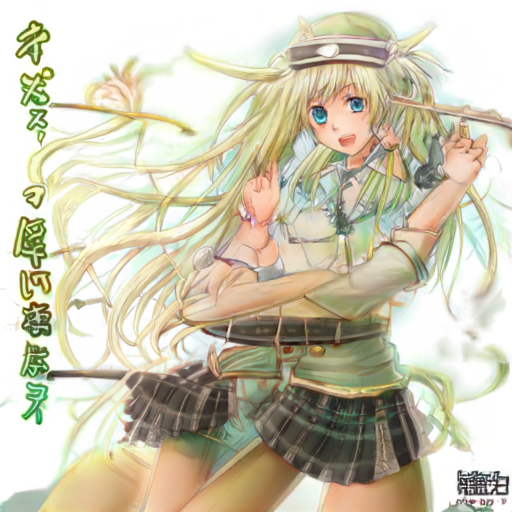

7 -0.16794787347316742 (0.161901593208313, 1.0010178, 1055.673095703125, -0.15774795413017273)


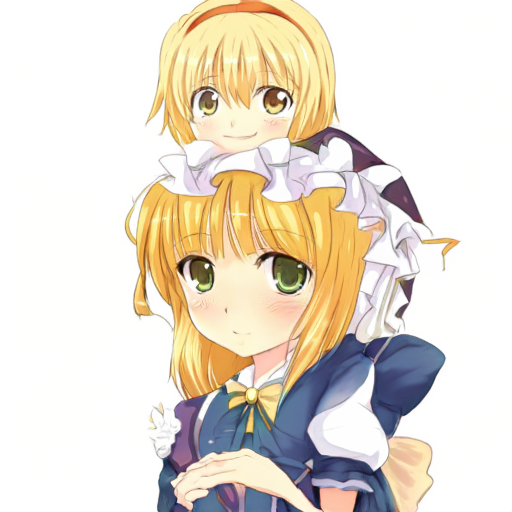

8 -0.16717076301574707 (0.15963318943977356, -2.3305647, 921.9539184570312, -0.15280090272426605)


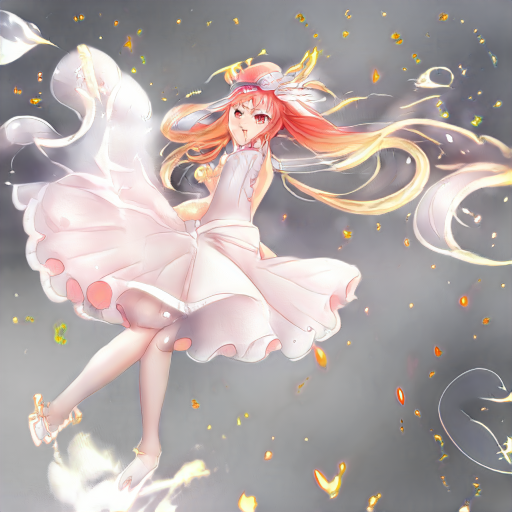

9 -0.16681545972824097 (0.17300045490264893, -3.2049267, 1019.9410400390625, -0.16481535136699677)


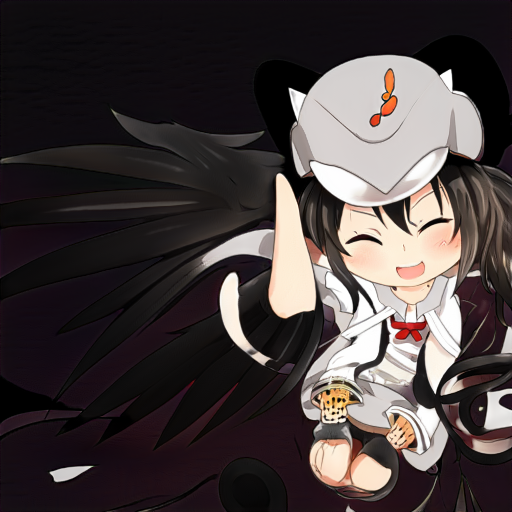

In [ ]:
results=searchAndClimb("a girl wearing a hat",1000,10,100,show=True)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

0 -0.18807107210159302 (0.23313482105731964, 0.86463547, 1002.5159912109375, -0.22910435497760773)


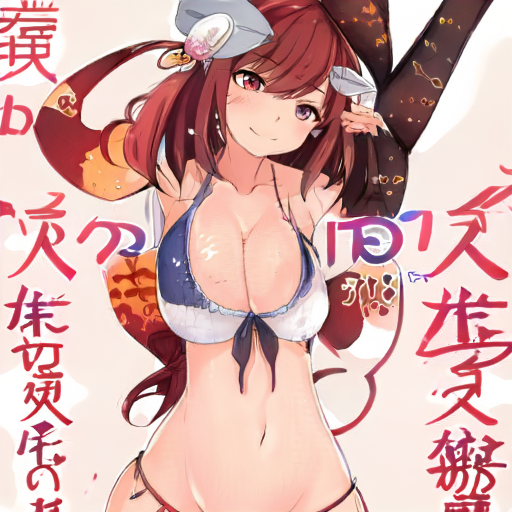

1 -0.1876155436038971 (0.21994532644748688, -5.584008, 1017.1046142578125, -0.20939499139785767)


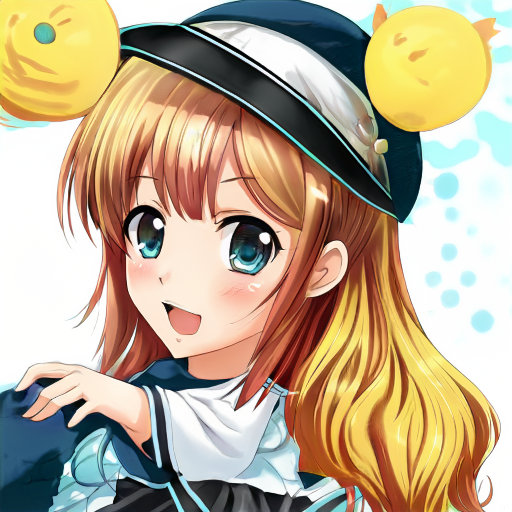

2 -0.18635284900665283 (0.23631396889686584, -0.48651624, 1014.0044555664062, -0.23087625205516815)


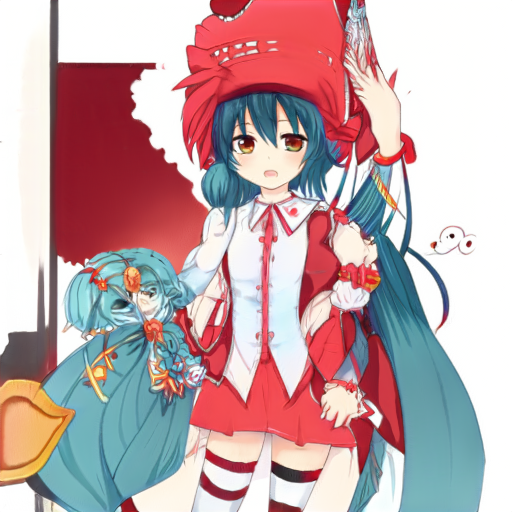

3 -0.1844872534275055 (0.2192973643541336, -1.0242257, 1035.9134521484375, -0.2132149636745453)


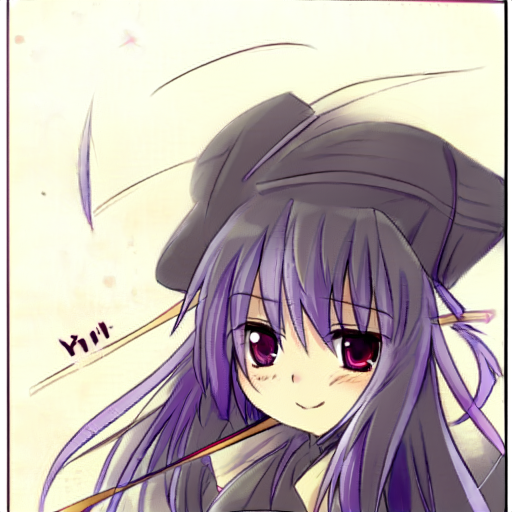

4 -0.18428237736225128 (0.21702376008033752, -3.9331672, 979.1062622070312, -0.20830979943275452)


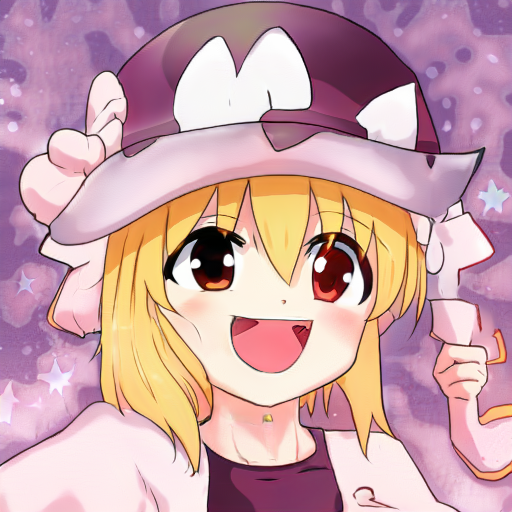

5 -0.1830008327960968 (0.2116185426712036, -0.2579267, 909.837646484375, -0.20691804587841034)


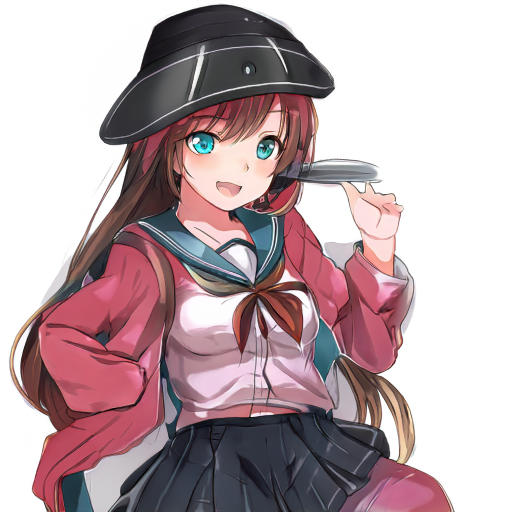

6 -0.18165884912014008 (0.22429436445236206, -1.6164751, 986.4903564453125, -0.21786104142665863)


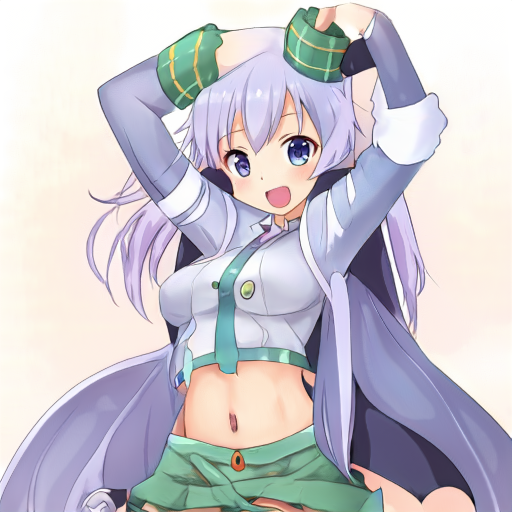

7 -0.1815491020679474 (0.22739239037036896, -1.8419433, 994.4110107421875, -0.22069492936134338)


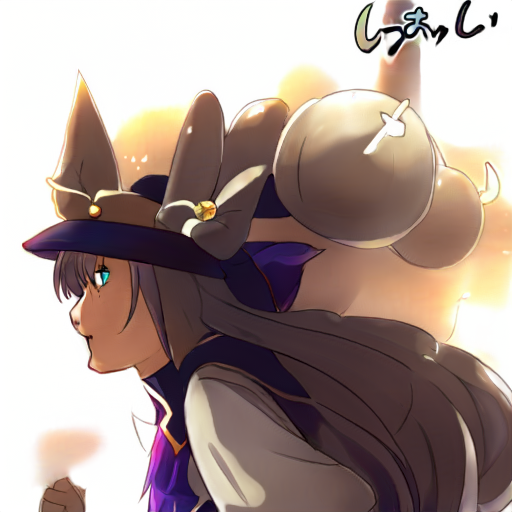

8 -0.1797671765089035 (0.20640434324741364, -1.6158407, 987.837646484375, -0.19996507465839386)


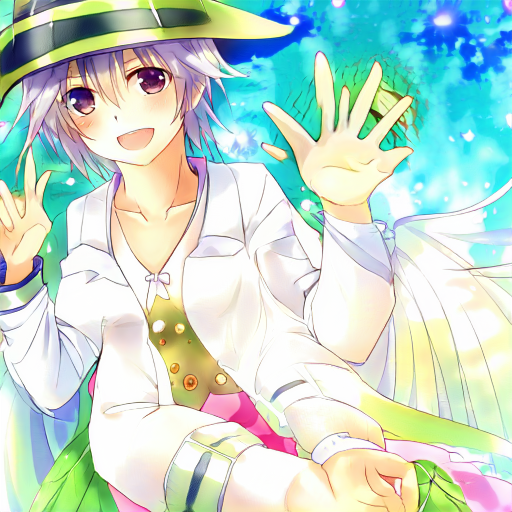

9 -0.1796155571937561 (0.20750759541988373, -3.6643407, 999.9945068359375, -0.19896046817302704)


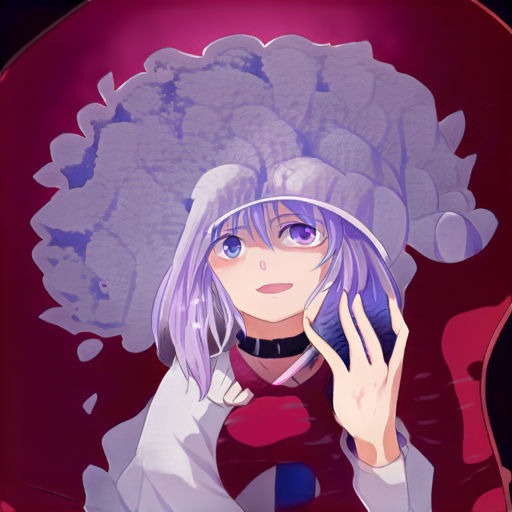

In [ ]:
results=searchAndClimb("a girl wearing a hat",1000,10,100,show=True)

In [ ]:
def displayLatent(latent,phi=1.0):
    with torch.no_grad():
      img_pt, _ = g(
          [torch.from_numpy(latent).to(device)],
          truncation=phi,
          truncation_latent=latent_avg.to(device),
          randomize_noise=False,
      )
    img=img_pt.cpu().numpy()[0]
    return fmtImg(img)

In [ ]:
def showResults(results):
  img = PIL.Image.fromarray(np.hstack([np.array(displayLatent(r)) for (r,s) in results]), 'RGB')
  return img

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

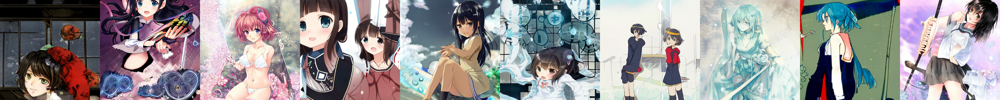

In [ ]:
results=searchAndClimb("a girl holding an umbrella",1000,10,100)
showResults(results)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

0 -0.23918206989765167 (0.26733842492103577, -3.8390372, 1056.9031982421875, -0.25833871960639954)


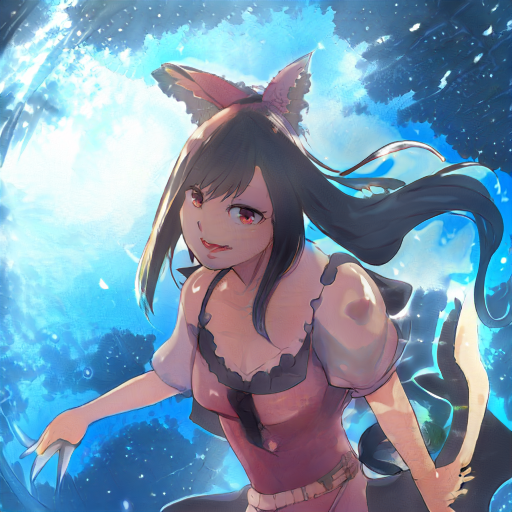

1 -0.23106913268566132 (0.2525840997695923, -1.458482, 983.87841796875, -0.24632152915000916)


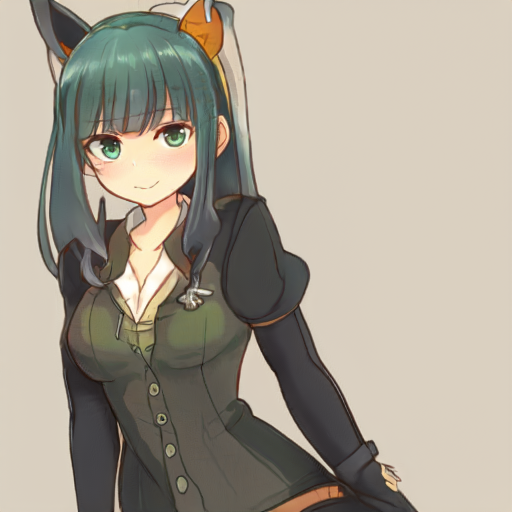

2 -0.2294333279132843 (0.2499912828207016, -1.7943203, 955.5855712890625, -0.2435310184955597)


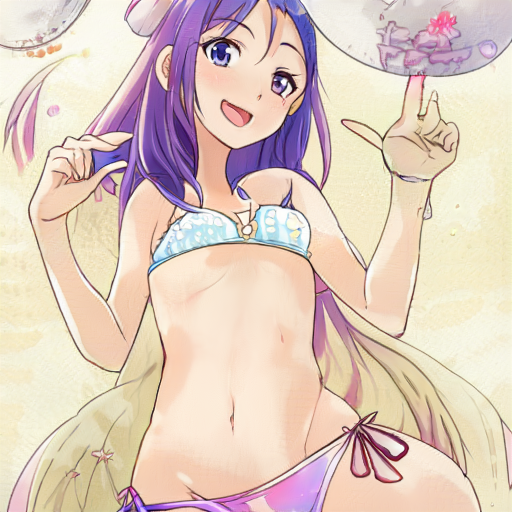

3 -0.22867810726165771 (0.26361948251724243, -0.41774893, 1087.1236572265625, -0.25789350271224976)


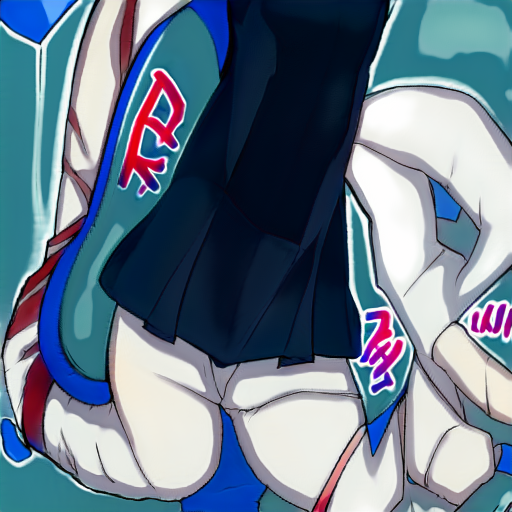

4 -0.22722502052783966 (0.26712703704833984, 0.013649464, 1043.107666015625, -0.2620473802089691)


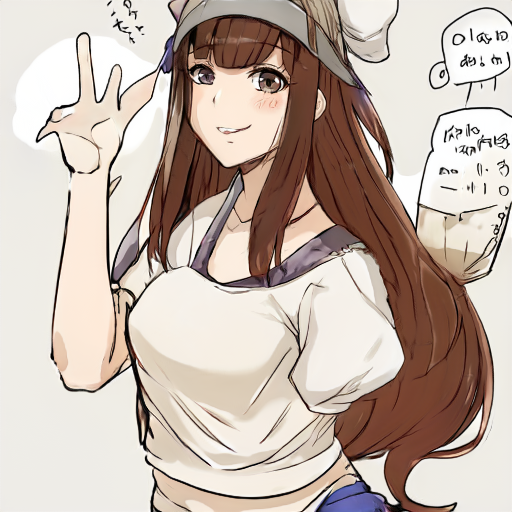

5 -0.22651585936546326 (0.24796558916568756, -2.6868956, 989.3078002929688, -0.24044808745384216)


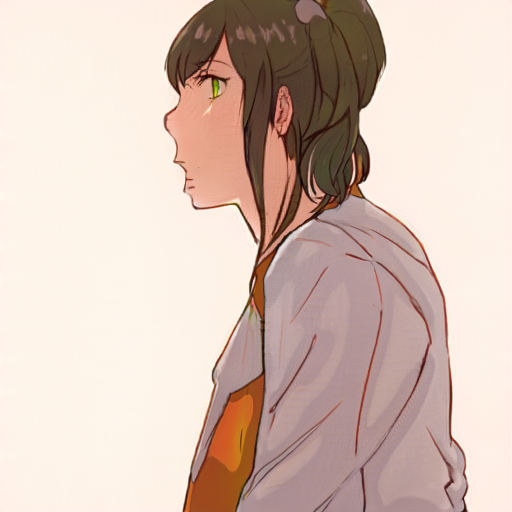

6 -0.2252199947834015 (0.2489122748374939, 0.07067013, 973.9967041015625, -0.2442270964384079)


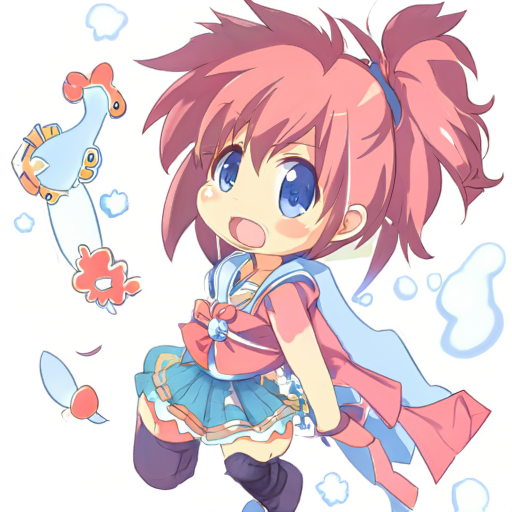

7 -0.2249002456665039 (0.24391233921051025, -2.836552, 1076.9110107421875, -0.23581743240356445)


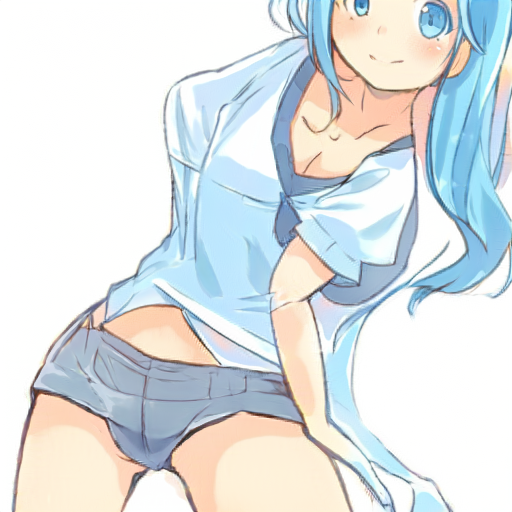

8 -0.22463613748550415 (0.24647845327854156, -0.7791207, 1077.2781982421875, -0.24043919146060944)


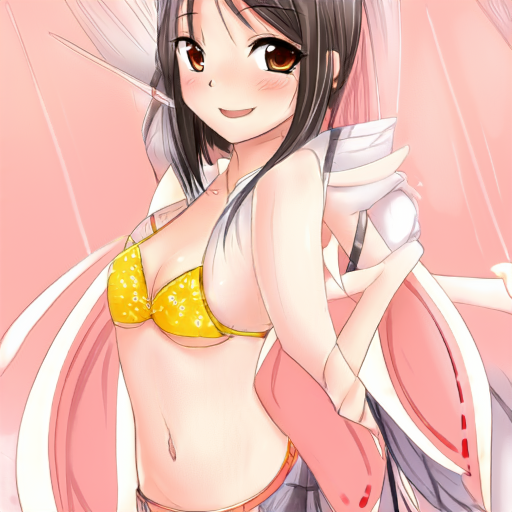

9 -0.22461262345314026 (0.24764634668827057, -2.983937, 1099.450927734375, -0.23929399251937866)


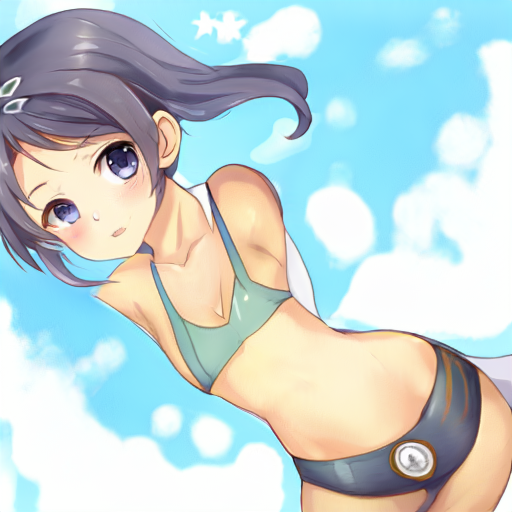

In [ ]:
results=searchAndClimb("a girl wearing a white wedding dress",1000,10,100,show=True)


  0%|          | 0/5000 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0 -0.2039334923028946 (0.20045433938503265, 0.169106, 1100.563232421875, -0.19524960219860077)


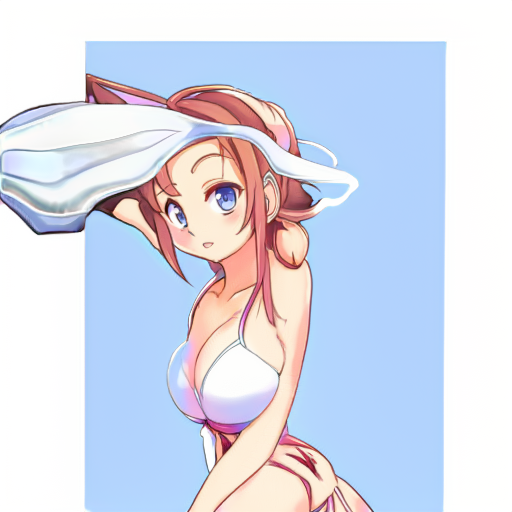

1 -0.19687111675739288 (0.18212845921516418, -0.83280945, 1032.822509765625, -0.1762525737285614)


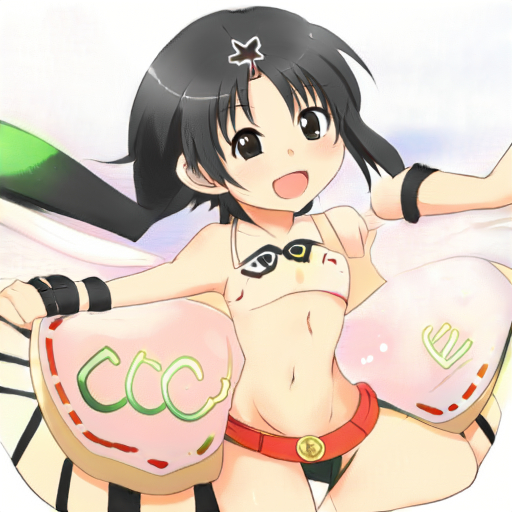

2 -0.19580404460430145 (0.14645685255527496, -2.0824082, 1041.5478515625, -0.1392887681722641)


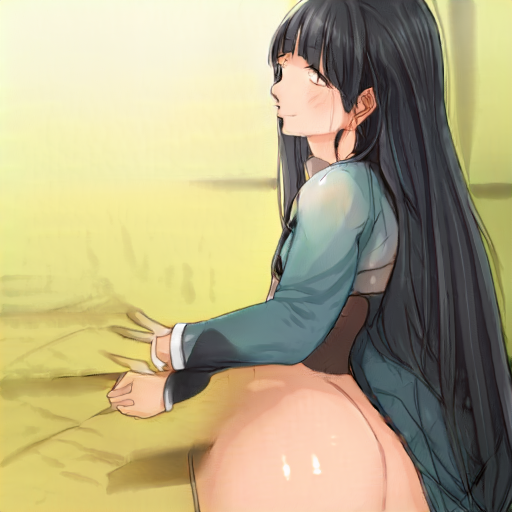

3 -0.19410015642642975 (0.20789414644241333, -0.37742424, 1008.8165283203125, -0.20259085297584534)


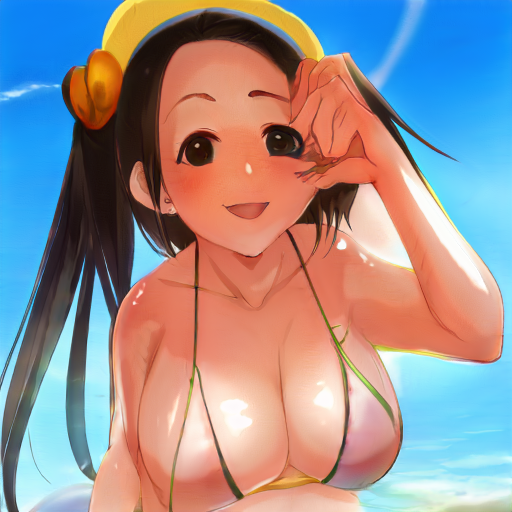

4 -0.19389869272708893 (0.1975778192281723, -2.2503774, 901.4469604492188, -0.19092585146427155)


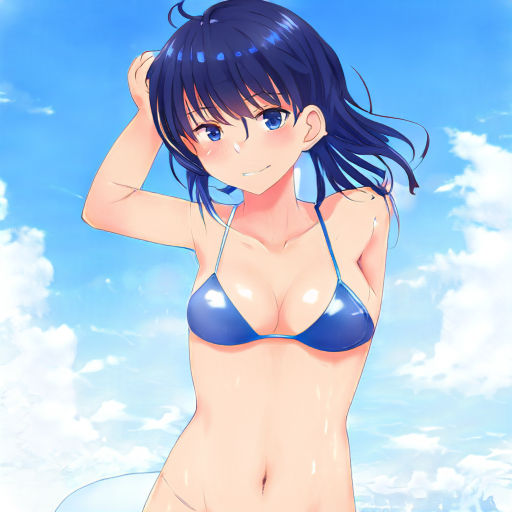

In [ ]:
results=searchAndClimb("a girl on the beach",5000,20,200,show=True)